In [99]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from netCDF4 import Dataset, num2date, date2num
from dask.distributed import Client
import xarray as xr
import fenics as fe
import yaml
import time as time_py
import logging
import os
import importlib
import pdb
import scipy as sp

In [100]:
import letkf_forecasting.letkf_io as letkf_io
import letkf_forecasting.letkf_forecasting as lf
import letkf_forecasting.random_functions as rf
import letkf_forecasting.tmh_plot as tp
import letkf_forecasting.advection
import letkf_forecasting.optical_flow
import letkf_forecasting.assimilation as assimilation
import letkf_forecasting.assimilation_accessories as aa
import letkf_forecasting.analyse_results as ar

In [101]:
%matplotlib inline

In [102]:
year = 2014
month = 5
day = 29

In [103]:
truth = xr.open_dataset(
    f'/a2/uaren/travis/data/{year:04}/{month:02}/{day:02}/data.nc')
truth = truth['ci']
truth = letkf_io.add_crop_attributes(truth)
truth_full = truth.copy()
truth = ar.return_error_domain(truth)

In [104]:
truth = truth.load()

In [105]:
importlib.reload(letkf_io)

<module 'letkf_forecasting.letkf_io' from '/home2/travis/python_code/letkf_forecasting/letkf_forecasting/letkf_io.py'>

In [106]:
base_folder = '/a2/uaren/travis/'
optimization_folder = 'results_opt'
run = 'owp_004_4p0_020_1p5_050_0p25'

In [107]:
importlib.reload(letkf_io)

<module 'letkf_forecasting.letkf_io' from '/home2/travis/python_code/letkf_forecasting/letkf_forecasting/letkf_io.py'>

In [108]:
full_day = letkf_io.return_day(year,
                               month,
                               day,
                               run,
                               base_folder,
                               optimization_folder)

/a2/uaren/travis/results_opt/2014/05/29/owp_004_4p0_020_1p5_050_0p25


In [109]:
full_day = letkf_io.add_crop_attributes(full_day)
full_day = full_day.load()
full_day_ed = ar.return_error_domain(full_day)

In [110]:
fd_mean = ar.return_ens_mean(full_day)

In [111]:
fd_mean_30 = ar.return_horizon(fd_mean, 30)

In [112]:
fd_ed_mean = ar.return_ens_mean(full_day_ed)

In [113]:
fore30 = ar.return_horizon(fd_ed_mean, 30)

In [114]:
full30 = ar.return_horizon(full_day_ed, 30)

In [115]:
wrf = letkf_io.return_day(year,
                          month,
                          day,
                          'wrf_mean',
                          base_folder)

/a2/uaren/travis/results/2014/05/29/wrf_mean


In [116]:
wrf = wrf.load()

In [117]:
wrf = letkf_io.add_crop_attributes(wrf)
wrf_ed = ar.return_error_domain(wrf)

In [118]:
wrf_ed_mean = ar.return_ens_mean(wrf_ed)

In [119]:
wrf30 = ar.return_horizon(wrf_ed_mean, 30)

In [120]:
wrf_full_30 = ar.return_horizon(wrf, 30)
wrf_full_30 = wrf_full_30.sel(ensemble_number=0)

In [121]:
truth_full = truth_full.sel(south_north=wrf.south_north,
                            west_east=wrf.west_east)

In [122]:
def U_plots(ensemble, time, mod):
    hour = time.hour
    minute = time.minute
#     fig, ax = tp.var_plot(
#         ensemble[:sys_vars.U_crop_size], sys_vars.U_crop_shape, 1)
#     fig.suptitle(f'variance of U; {mod}; {hour:02}:{minute:02}')
#     plt.show()
    
#     fig, ax = tp.ensemble_stamps(
#         [], [], ensemble[:sys_vars.U_crop_size], 2, 3, 
#         sys_vars.U_crop_shape, 1.02,
#         cmap='bwr', vmin=None)
#     fig.suptitle(f'U mean and samples; {mod}; {hour:02}:{minute:02}')
#     plt.show()
    vmax = abs(ensemble).max()
    fig, ax = tp.ensemble_stamps_cdf(
        [], [], ensemble, 2, 3, 
        ensemble.isel(ensemble_number=0).shape, 1.02, cmap='bwr',
        vmin=-vmax, vmax=vmax, nc=31)
    fig.suptitle(f'U mean and samples; {mod}; {hour:02}:{minute:02}')
    plt.show()
    
def V_plots(ensemble, time, mod):
    hour = time.hour
    minute = time.minute
    fig, ax = tp.var_plot(
        ensemble[sys_vars.U_crop_size: sys_vars.wind_size],
        sys_vars.V_crop_shape, 1)
    fig.suptitle(f'variance of V; {mod}; {hour:02}:{minute:02}')
    fig.show()
    
    fig, ax = tp.ensemble_stamps(
        [], [], ensemble[sys_vars.U_crop_size: sys_vars.wind_size],
        2, 3, sys_vars.V_crop_shape, 1.02,
        cmap='bwr', vmin=None)
    fig.suptitle(f'V mean and samples; {mod}; {hour:02}:{minute:02}')
    plt.show()

def ci_plots(ensemble, time, mod):
    hour = time.hour
    minute = time.minute
#     median = ensemble.median(dim='ensemble_number')
#     fig, ax = tp.ensemble_stamps_cdf(
#         [median], ['median'], ensemble, 2, 3, 
#         ensemble.isel(ensemble_number=0).shape, 1.02, cmap='Blues_r')
    fig, ax = tp.ensemble_stamps_cdf(
        [], [], ensemble, 2, 3, 
        ensemble.isel(ensemble_number=0).shape, 1.02, cmap='Blues_r')
    fig.suptitle(f'CI mean and samples; {mod}; {hour:02}:{minute:02}')
    plt.show()

<xarray.DataArray 'time' ()>
array(1401382800000000000, dtype='datetime64[ns]')
Coordinates:
    time     datetime64[ns] 2014-05-29T17:00:00
/a2/uaren/travis/
results_opt
owp_004_4p0_020_1p5_050_0p25


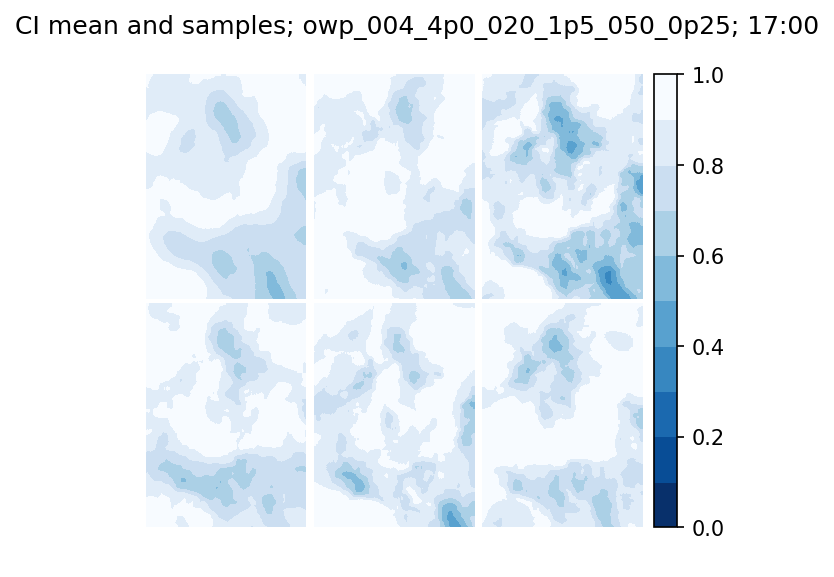

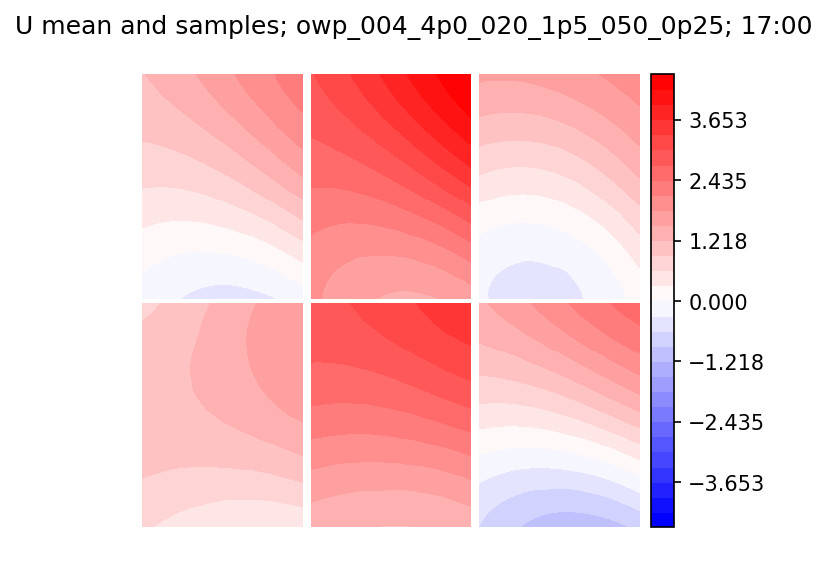

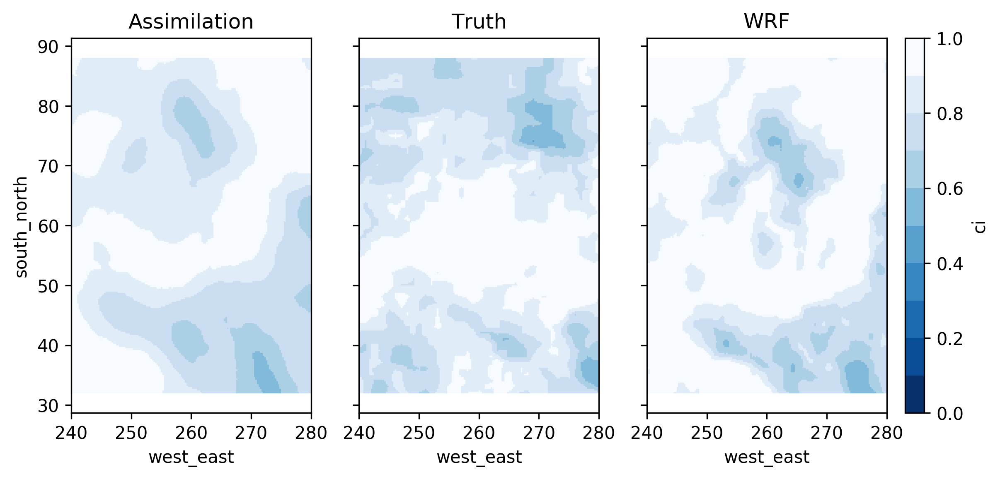

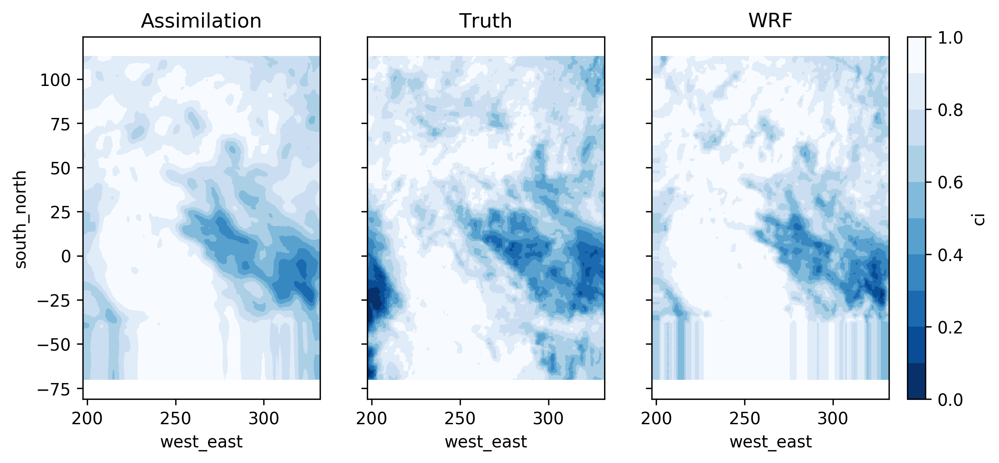

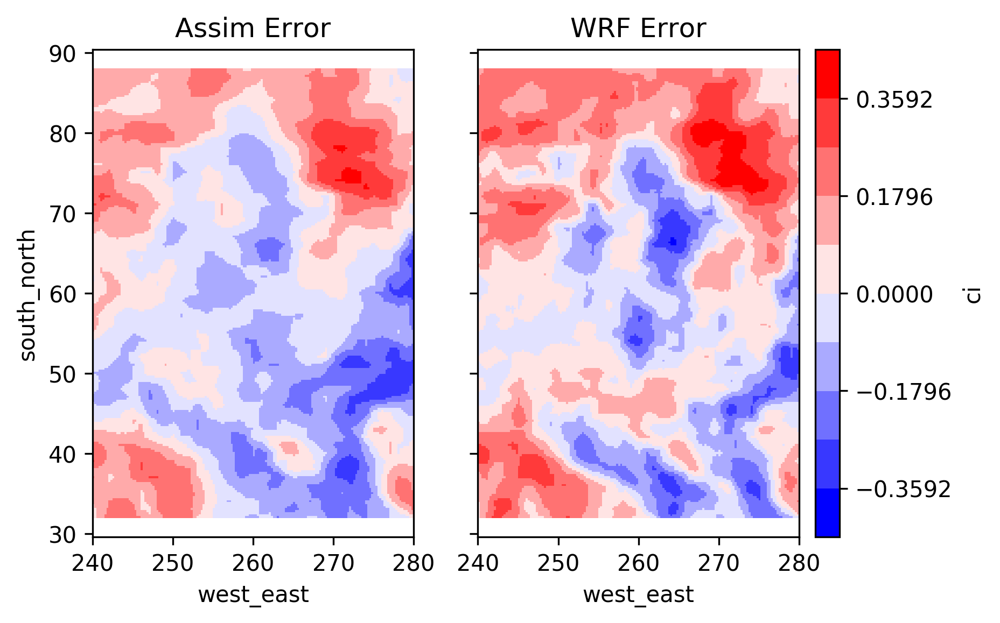

...

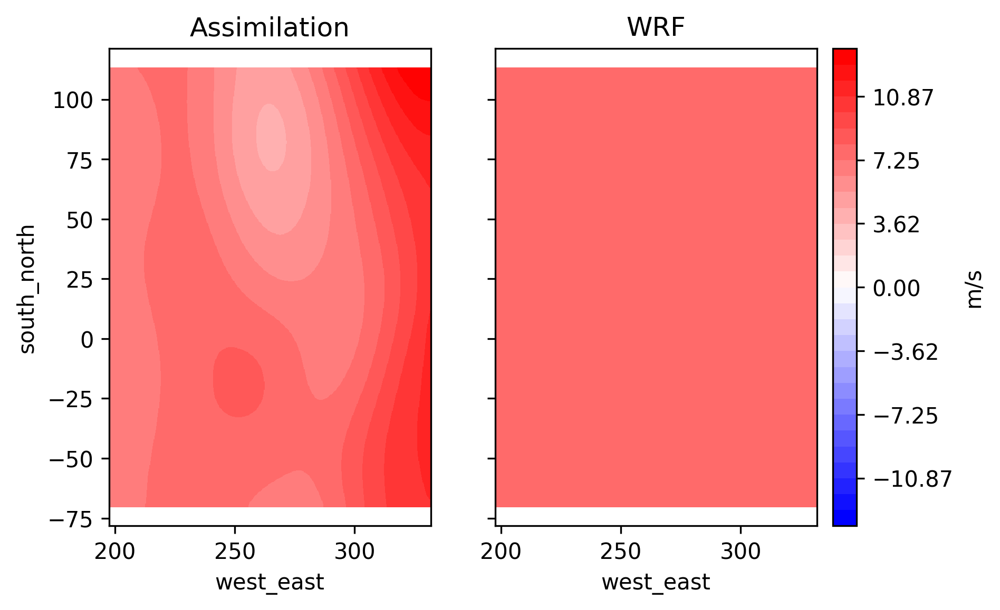

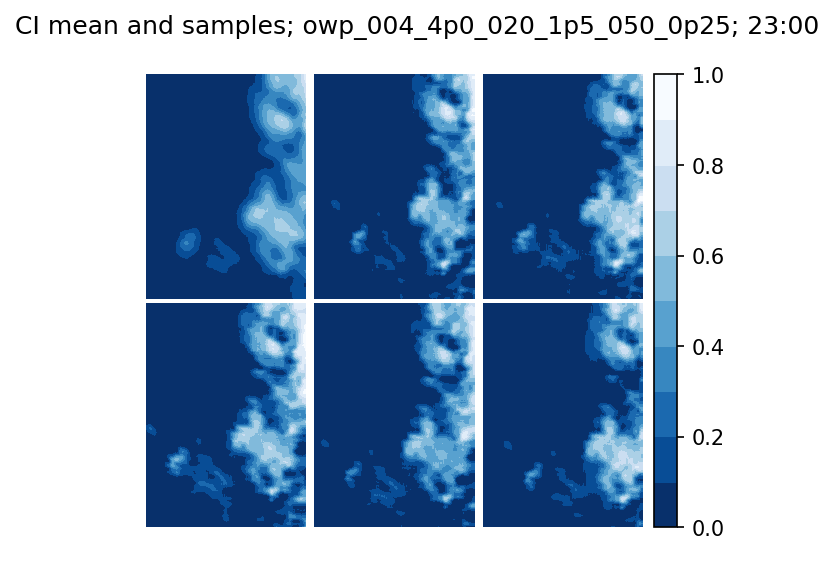

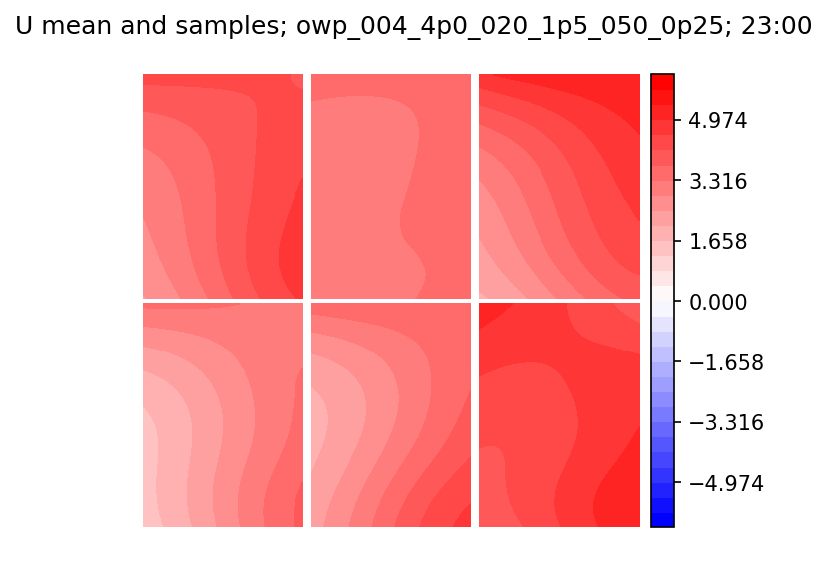

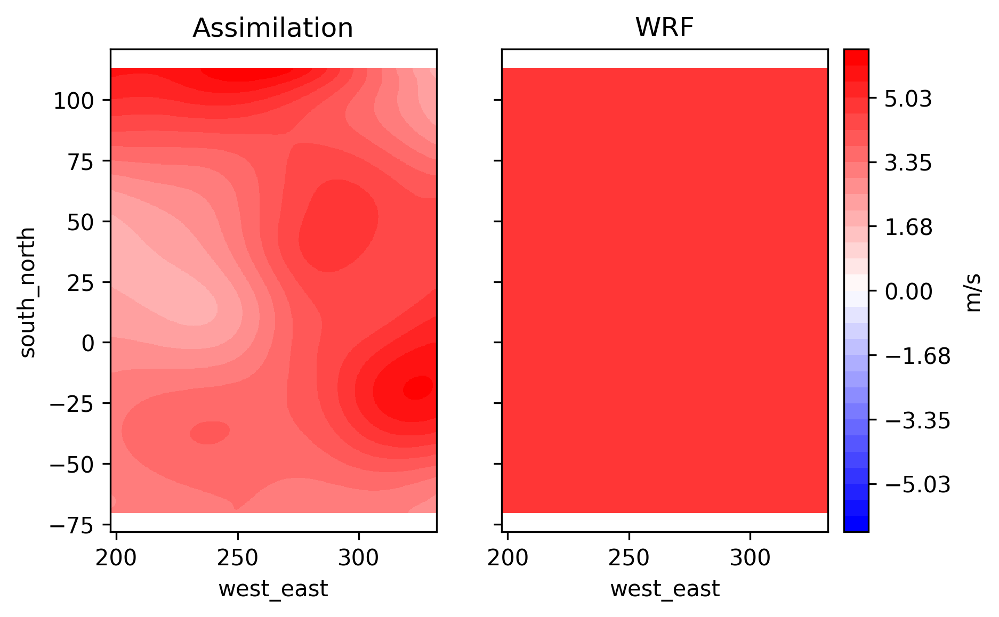

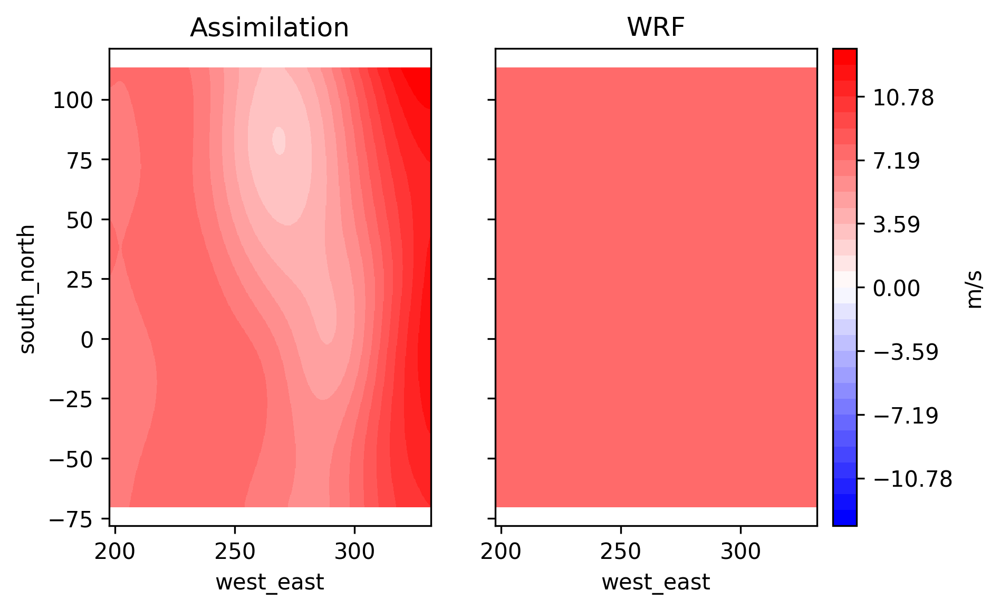

In [123]:
print(full30.time[0])
print(base_folder)
print(optimization_folder)
print(run)
for t in full30.time.values:
    ci_plots(full30['ci'].sel(time=t), pd.Timestamp(t), run)
    U_plots(full30['U'].sel(time=t), pd.Timestamp(t), run)
    
    if t in truth.time.values:
        data = [fore30['ci'].sel(time=t).values, truth.sel(time=t).values, wrf30['ci'].sel(time=t).values]
        tp.subplots(data, truth.west_east, truth.south_north,
                    ['Assimilation', 'Truth', 'WRF'], ['west_east', 'south_north'],
                    cb_label='ci', cmap='Blues_r')
        
        
        data = [fd_mean_30['ci'].sel(time=t).values,
                truth_full.sel(time=t).values,
                wrf_full_30['ci'].sel(time=t).values]
        tp.subplots(data, truth_full.west_east, truth_full.south_north,
                    ['Assimilation', 'Truth', 'WRF'], ['west_east', 'south_north'],
                    cb_label='ci', cmap='Blues_r')
        
        error_assim = (fore30['ci'].sel(time=t) - truth.sel(time=t))
        error_wrf = (wrf30['ci'].sel(time=t) - truth.sel(time=t))
        vmax = error_assim.max()
        vmax = np.max([vmax, error_wrf.max()])
        data = [error_assim, error_wrf]
        tp.subplots(data, truth.west_east, truth.south_north,
                    ['Assim Error', 'WRF Error'], ['west_east', 'south_north'], cmap='bwr', vmax=vmax,
                    cb_label='ci')
    
    data = [fd_mean_30['U'].sel(time=t).values,
            wrf_full_30['U'].sel(time=t).values]
    vmax = np.max(list(map(lambda x: np.abs(x).max(), data)))
    tp.subplots(data, fd_mean_30.west_east_stag, fd_mean_30.south_north,
                ['Assimilation', 'WRF'], ['west_east', 'south_north'],
                cb_label='m/s', cmap='bwr', vmax=vmax, nc=31)
    
    data = [fd_mean_30['V'].sel(time=t).values,
            wrf_full_30['V'].sel(time=t).values]
    vmax = np.max(list(map(lambda x: np.abs(x).max(), data)))
    tp.subplots(data, fd_mean_30.west_east, fd_mean_30.south_north_stag,
                ['Assimilation', 'WRF'], ['west_east', 'south_north'],
                cb_label='m/s', cmap='bwr', vmax=vmax, nc=31)

<xarray.DataArray 'time' ()>
array(1401382800000000000, dtype='datetime64[ns]')
Coordinates:
    time     datetime64[ns] 2014-05-29T17:00:00
/a2/uaren/travis/
results_opt
ow_004_4p0_020_1p5_000_0


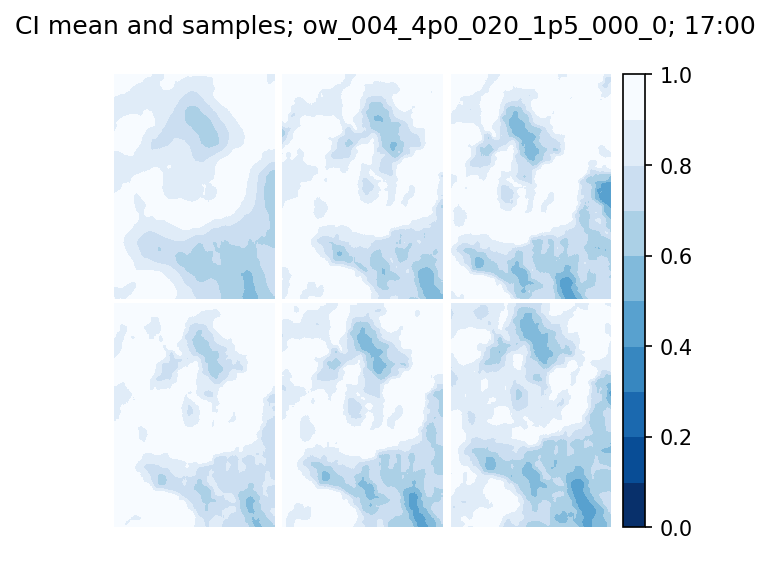

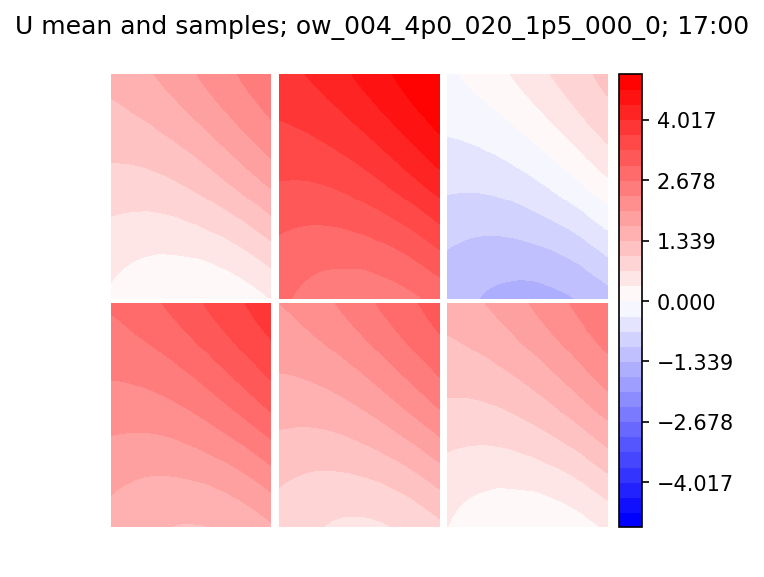

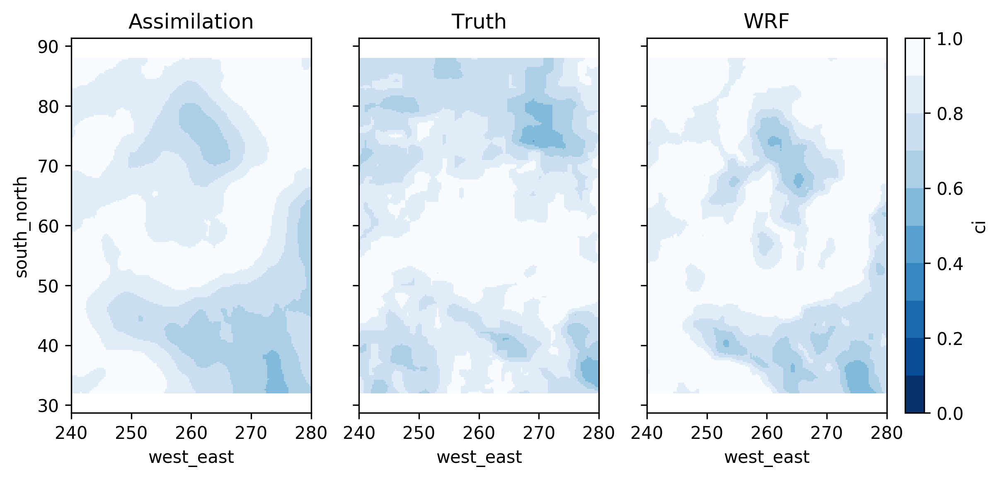

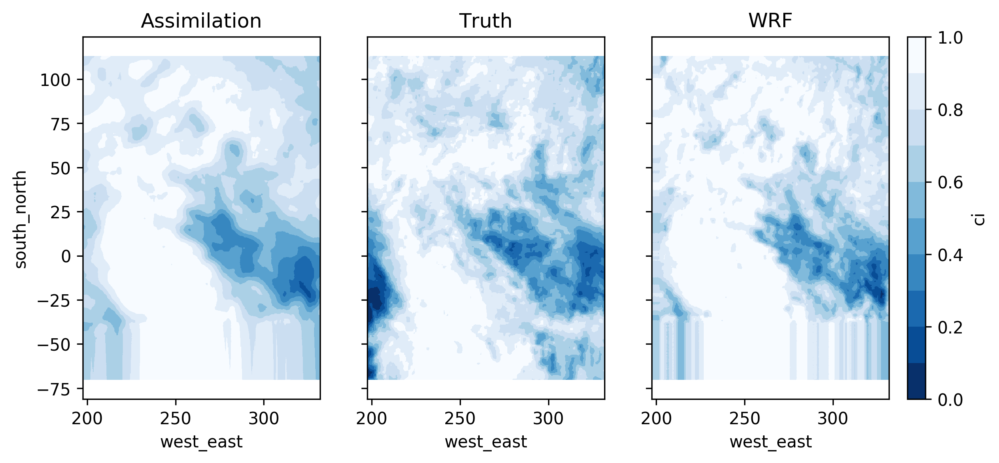

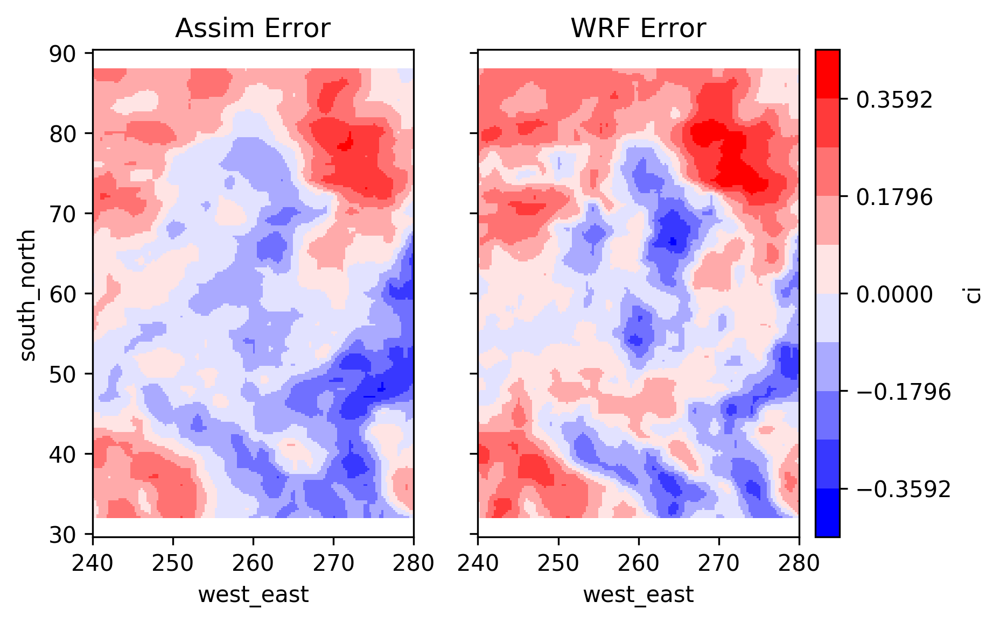

...

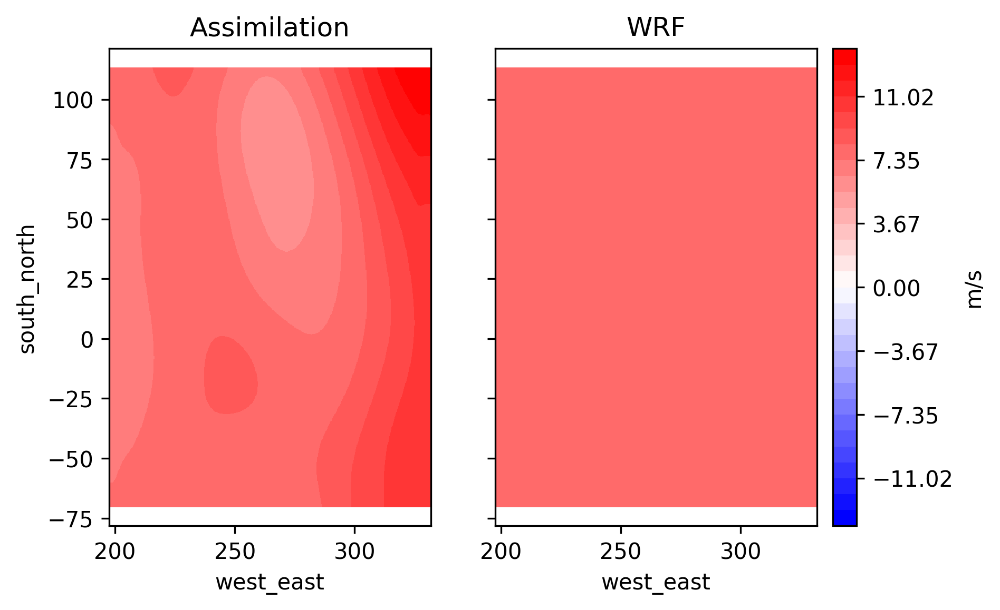

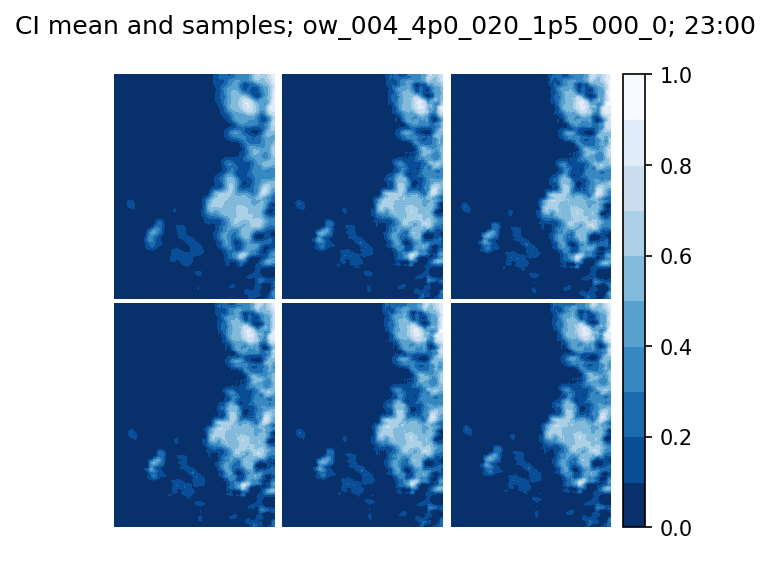

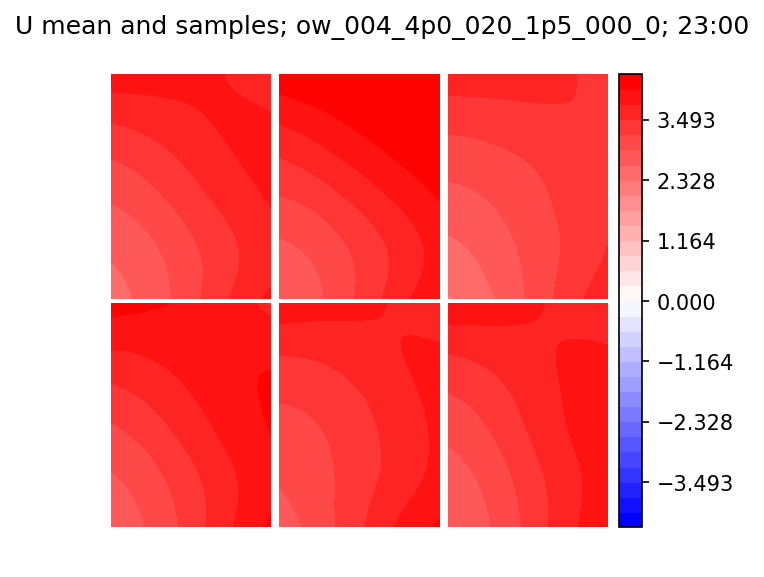

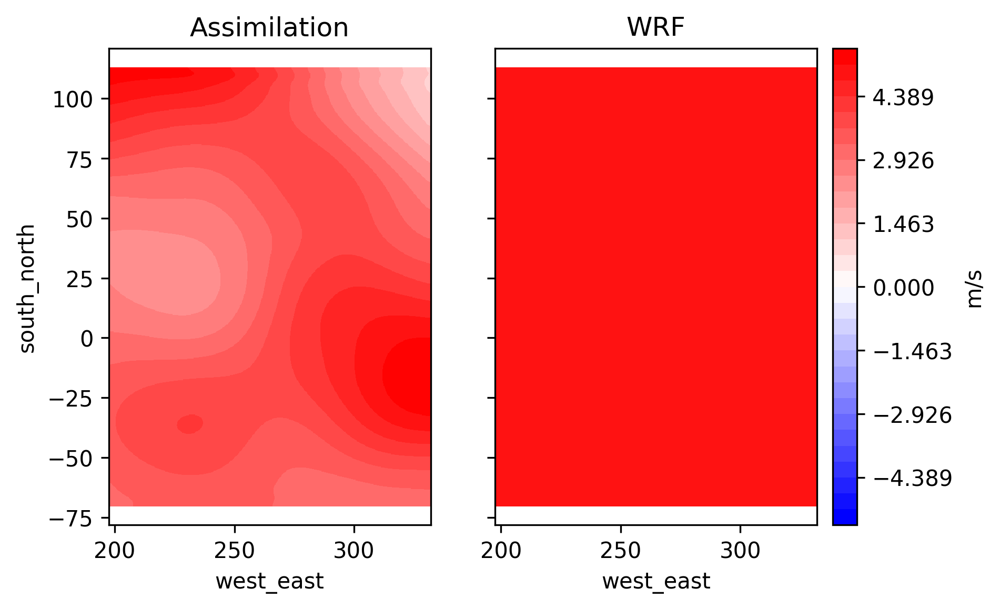

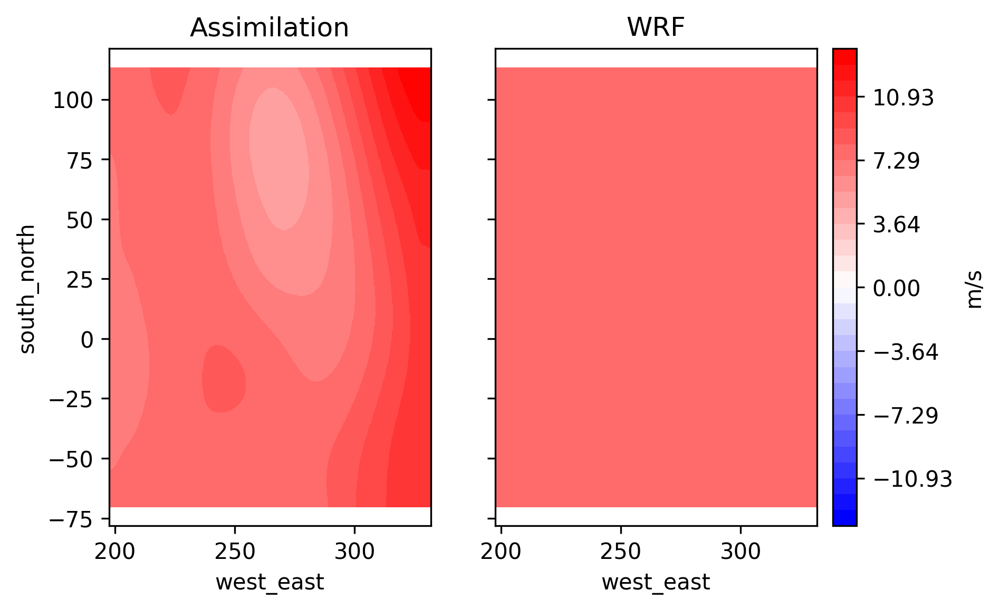

In [98]:
print(full30.time[0])
print(base_folder)
print(optimization_folder)
print(run)
for t in full30.time.values:
    ci_plots(full30['ci'].sel(time=t), pd.Timestamp(t), run)
    U_plots(full30['U'].sel(time=t), pd.Timestamp(t), run)
    
    if t in truth.time.values:
        data = [fore30['ci'].sel(time=t).values, truth.sel(time=t).values, wrf30['ci'].sel(time=t).values]
        tp.subplots(data, truth.west_east, truth.south_north,
                    ['Assimilation', 'Truth', 'WRF'], ['west_east', 'south_north'],
                    cb_label='ci', cmap='Blues_r')
        
        
        data = [fd_mean_30['ci'].sel(time=t).values,
                truth_full.sel(time=t).values,
                wrf_full_30['ci'].sel(time=t).values]
        tp.subplots(data, truth_full.west_east, truth_full.south_north,
                    ['Assimilation', 'Truth', 'WRF'], ['west_east', 'south_north'],
                    cb_label='ci', cmap='Blues_r')
        
        error_assim = (fore30['ci'].sel(time=t) - truth.sel(time=t))
        error_wrf = (wrf30['ci'].sel(time=t) - truth.sel(time=t))
        vmax = error_assim.max()
        vmax = np.max([vmax, error_wrf.max()])
        data = [error_assim, error_wrf]
        tp.subplots(data, truth.west_east, truth.south_north,
                    ['Assim Error', 'WRF Error'], ['west_east', 'south_north'], cmap='bwr', vmax=vmax,
                    cb_label='ci')
    
    data = [fd_mean_30['U'].sel(time=t).values,
            wrf_full_30['U'].sel(time=t).values]
    vmax = np.max(list(map(lambda x: np.abs(x).max(), data)))
    tp.subplots(data, fd_mean_30.west_east_stag, fd_mean_30.south_north,
                ['Assimilation', 'WRF'], ['west_east', 'south_north'],
                cb_label='m/s', cmap='bwr', vmax=vmax, nc=31)
    
    data = [fd_mean_30['V'].sel(time=t).values,
            wrf_full_30['V'].sel(time=t).values]
    vmax = np.max(list(map(lambda x: np.abs(x).max(), data)))
    tp.subplots(data, fd_mean_30.west_east, fd_mean_30.south_north_stag,
                ['Assimilation', 'WRF'], ['west_east', 'south_north'],
                cb_label='m/s', cmap='bwr', vmax=vmax, nc=31)

<xarray.DataArray 'time' ()>
array(1397581200000000000, dtype='datetime64[ns]')
Coordinates:
    time     datetime64[ns] 2014-04-15T17:00:00


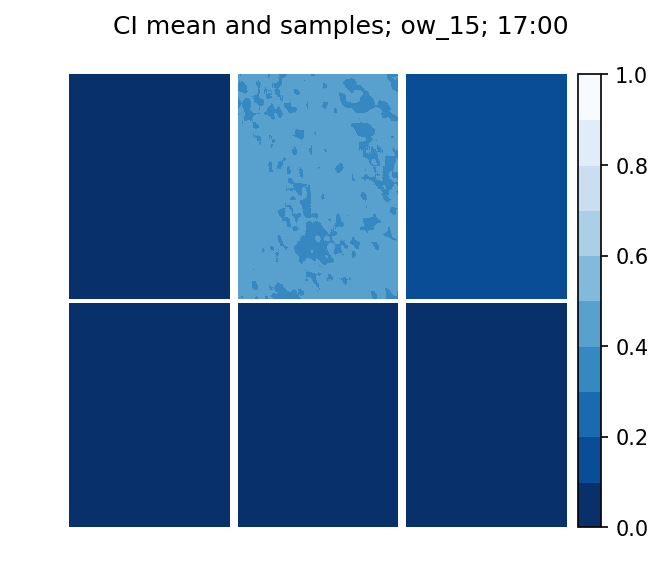

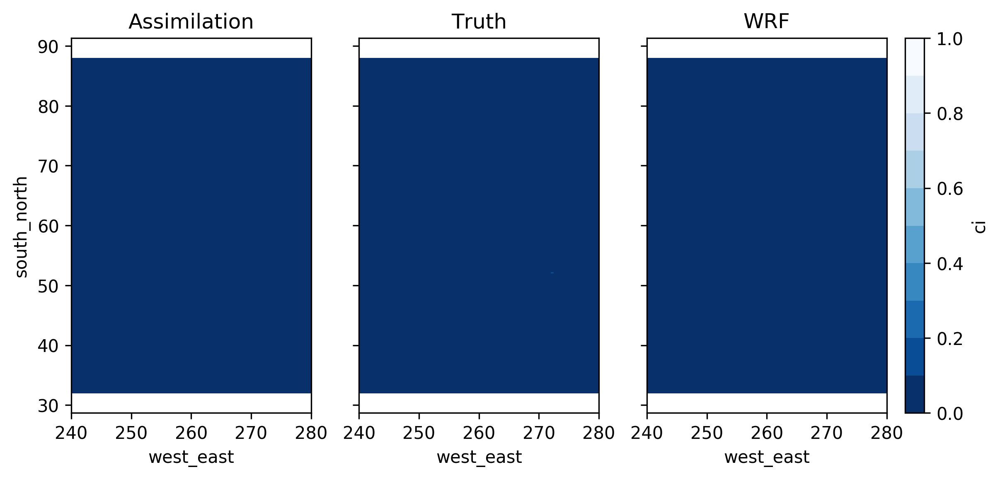

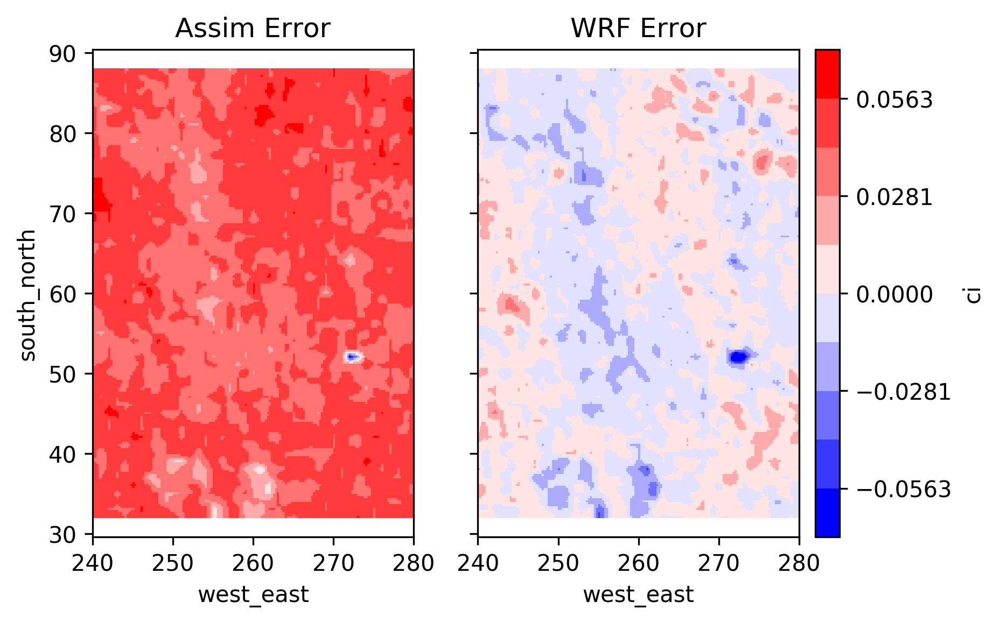

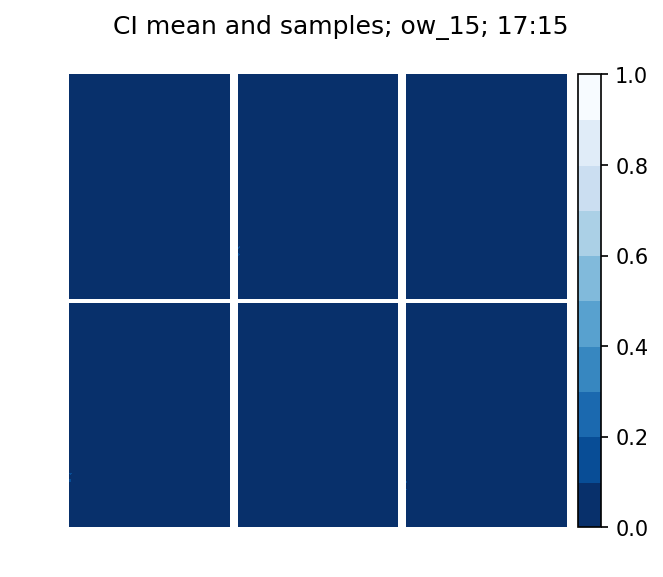

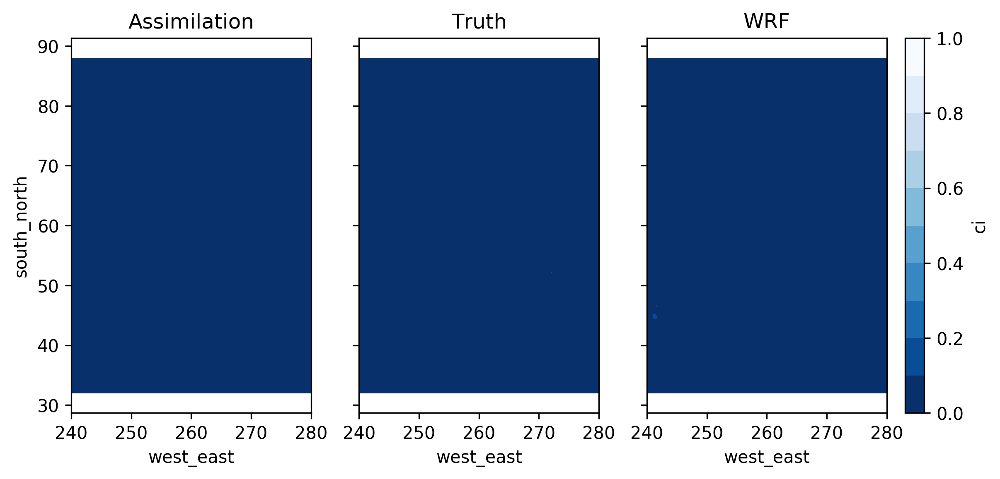

...

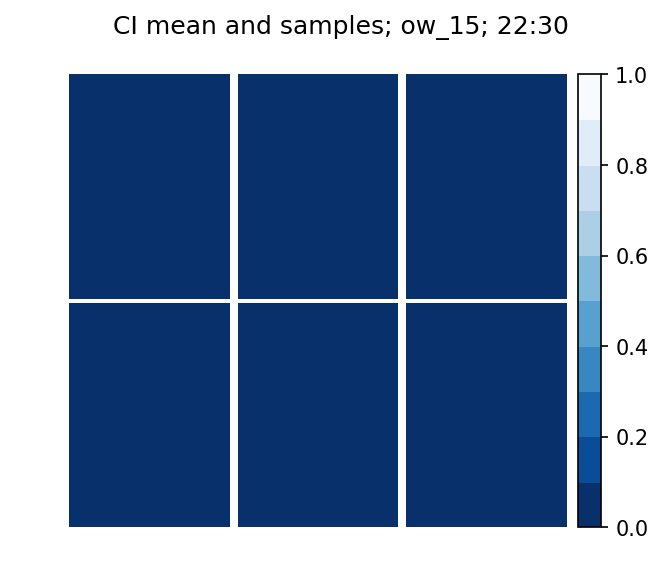

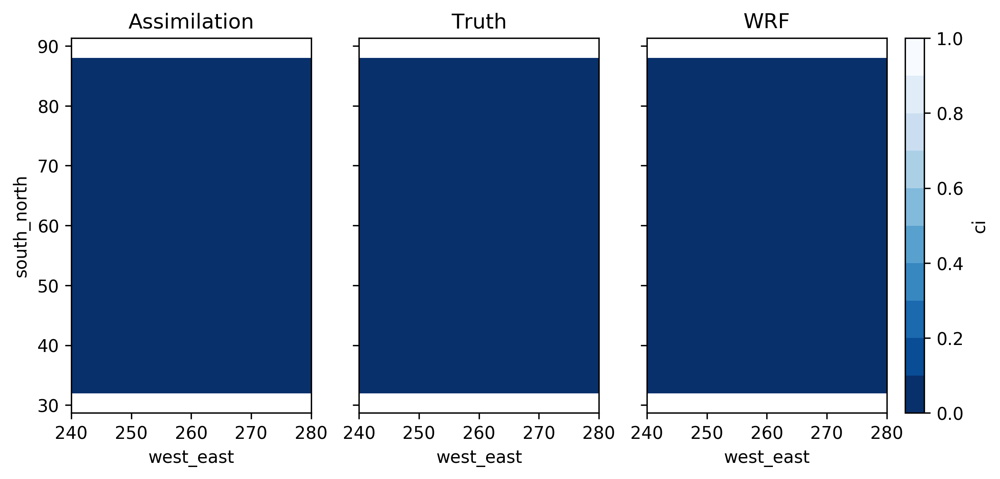

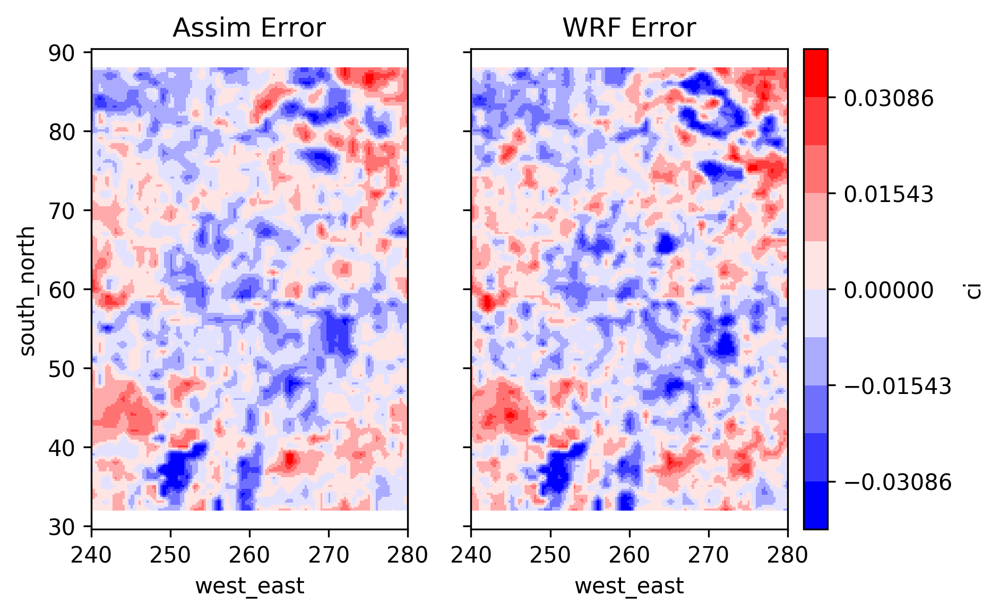

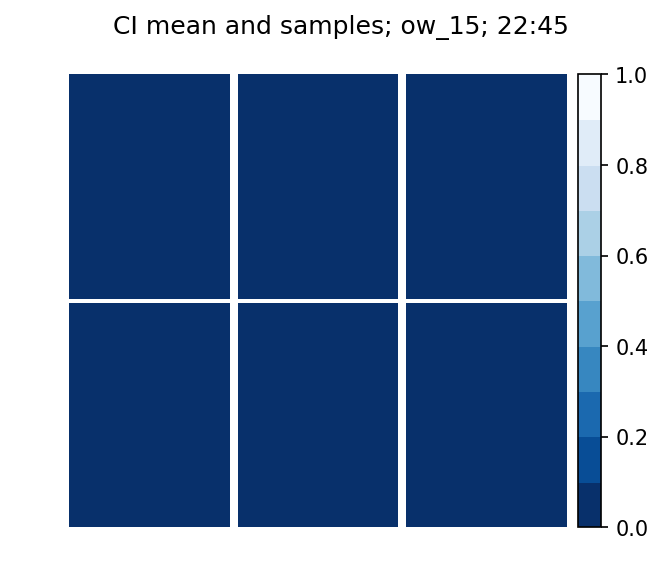

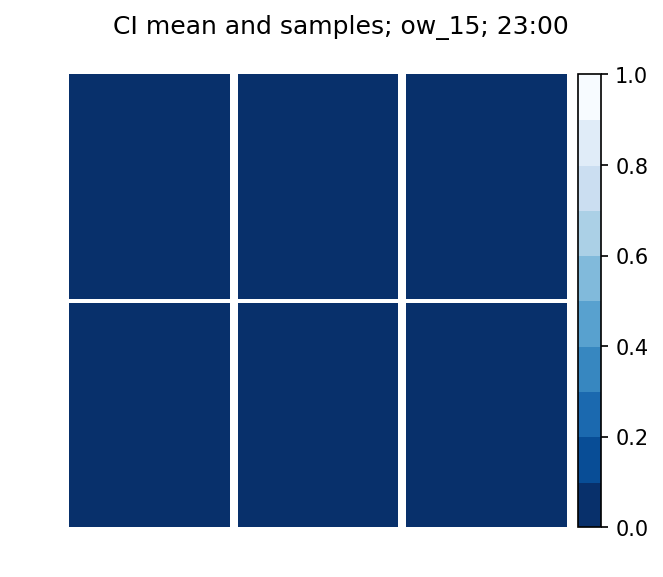

In [26]:
print(full30.time[0])
for t in full30.time.values:
    ci_plots(full30['ci'].sel(time=t), pd.Timestamp(t), 'ow_15')
    
    if t in truth.time.values:
        data = [fore30['ci'].sel(time=t).values, truth.sel(time=t).values, wrf30['ci'].sel(time=t).values]
        tp.subplots(data, truth.west_east, truth.south_north,
                    ['Assimilation', 'Truth', 'WRF'], ['west_east', 'south_north'],
                    cb_label='ci', cmap='Blues_r')
        
        error_assim = (fore30['ci'].sel(time=t) - truth.sel(time=t))
        error_wrf = (wrf30['ci'].sel(time=t) - truth.sel(time=t))
        vmax = error_assim.max()
        vmax = np.max([vmax, error_wrf.max()])
        data = [error_assim, error_wrf]
        tp.subplots(data, truth.west_east, truth.south_north,
                    ['Assim Error', 'WRF Error'], ['west_east', 'south_north'], cmap='bwr', vmax=vmax,
                    cb_label='ci')
        
#         plt.figure()
#         truth.sel(time=t).plot(
#             cmap='Blues_r', vmin=0, vmax=1)
#         plt.axis('equal')
        
#         plt.figure()
#         fore30['ci'].sel(time=t).plot(
#             cmap='Blues', vmin=0, vmax=1)
#         plt.axis('equal')
        
#         error = (fore30['ci'].sel(time=t) - truth.sel(time=t))
#         plt.figure()
#         error.plot(
#             cmap='bwr')
#         plt.axis('equal')
        
#         plt.figure()
#         wrf30['ci'].sel(time=t).plot(
#             cmap='Blues_r', vmin=0, vmax=1)
#         plt.axis('equal')
        
#         error = (wrf30['ci'].sel(time=t) - truth.sel(time=t))
#         plt.figure()
#         error.plot(
#             cmap='bwr')
#         plt.axis('equal')

(<matplotlib.figure.Figure at 0x7fe78defa748>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe78e04cf60>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x7fe79dfb9cc0>], dtype=object))

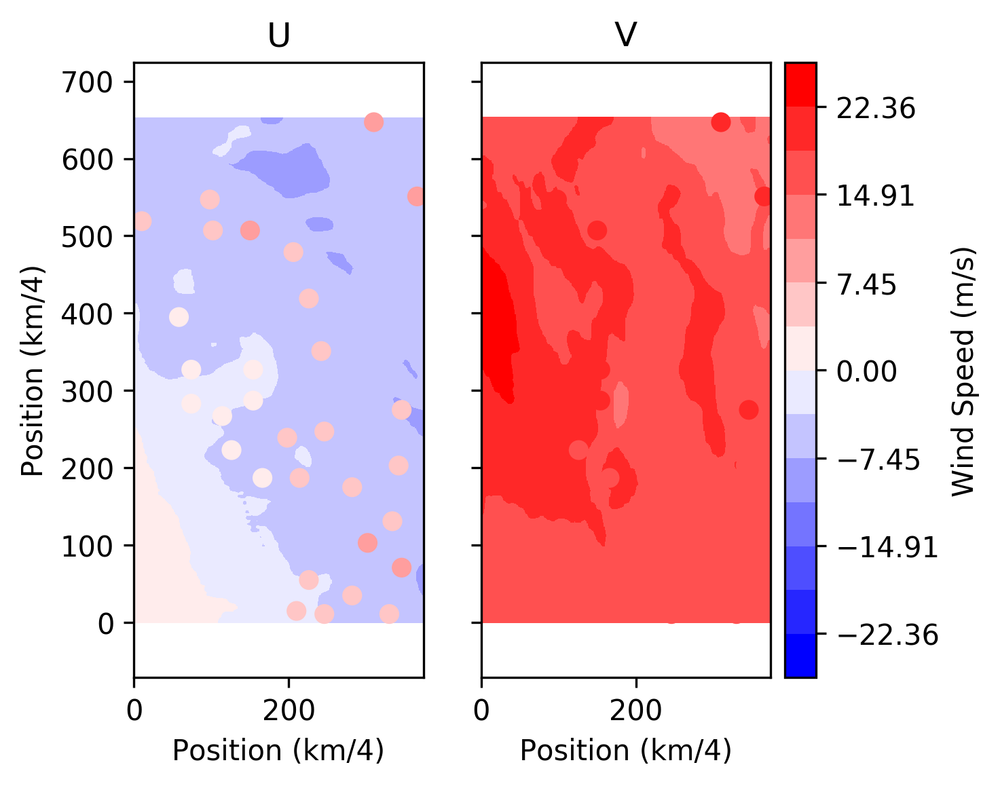

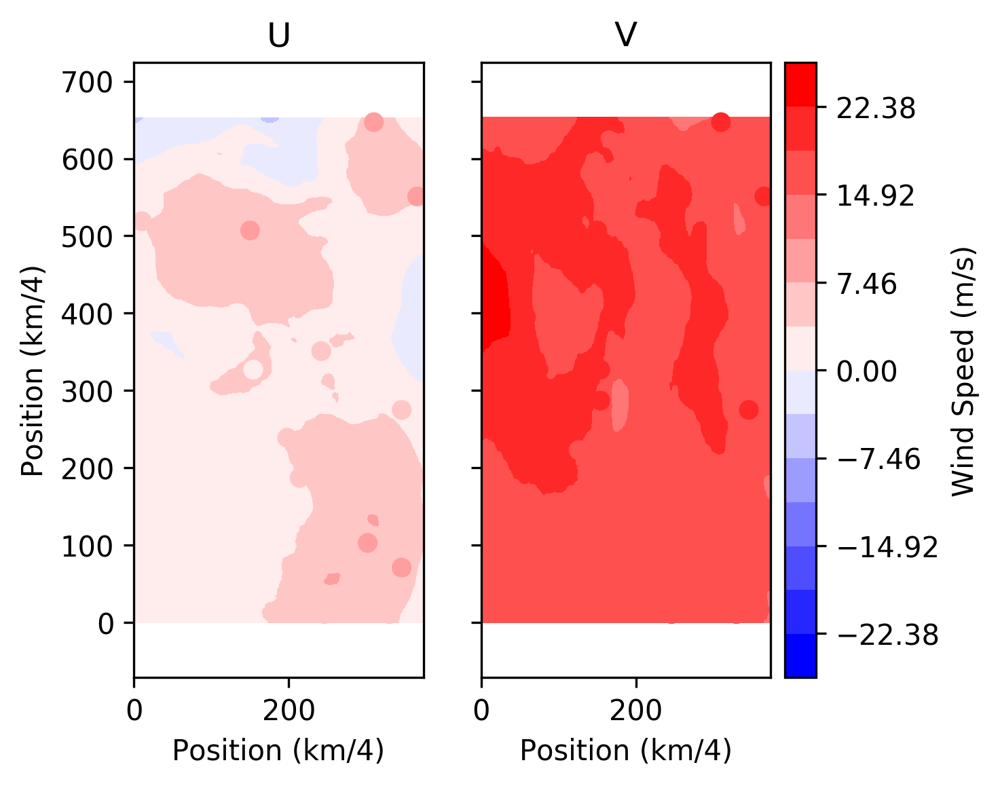

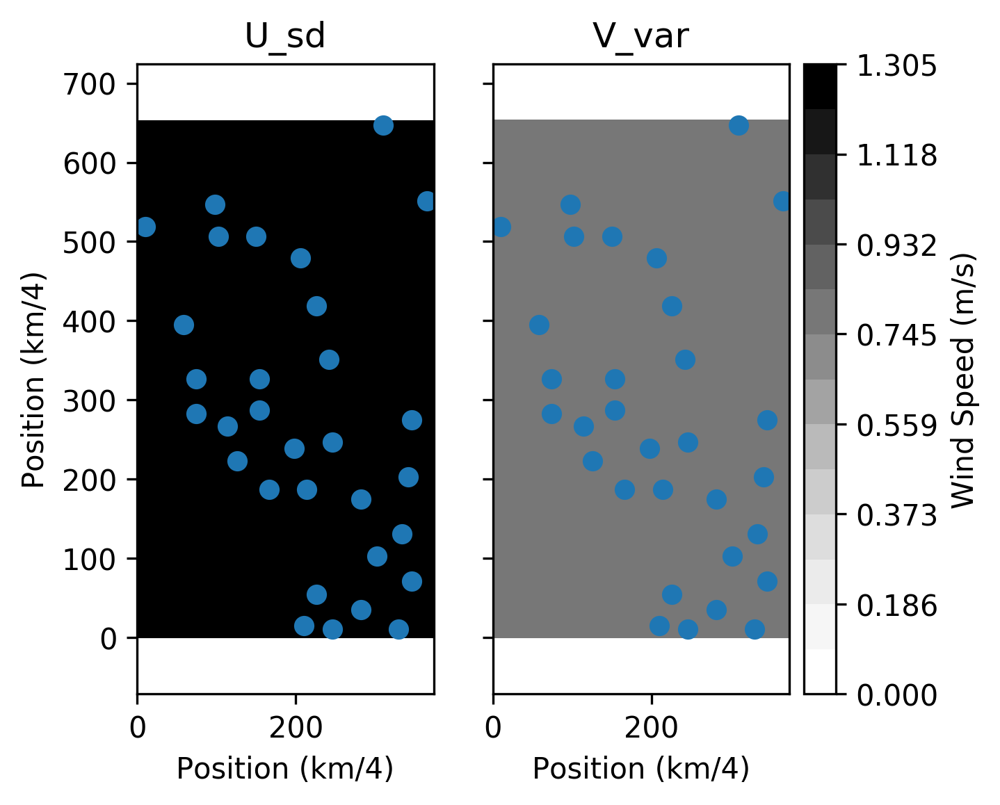

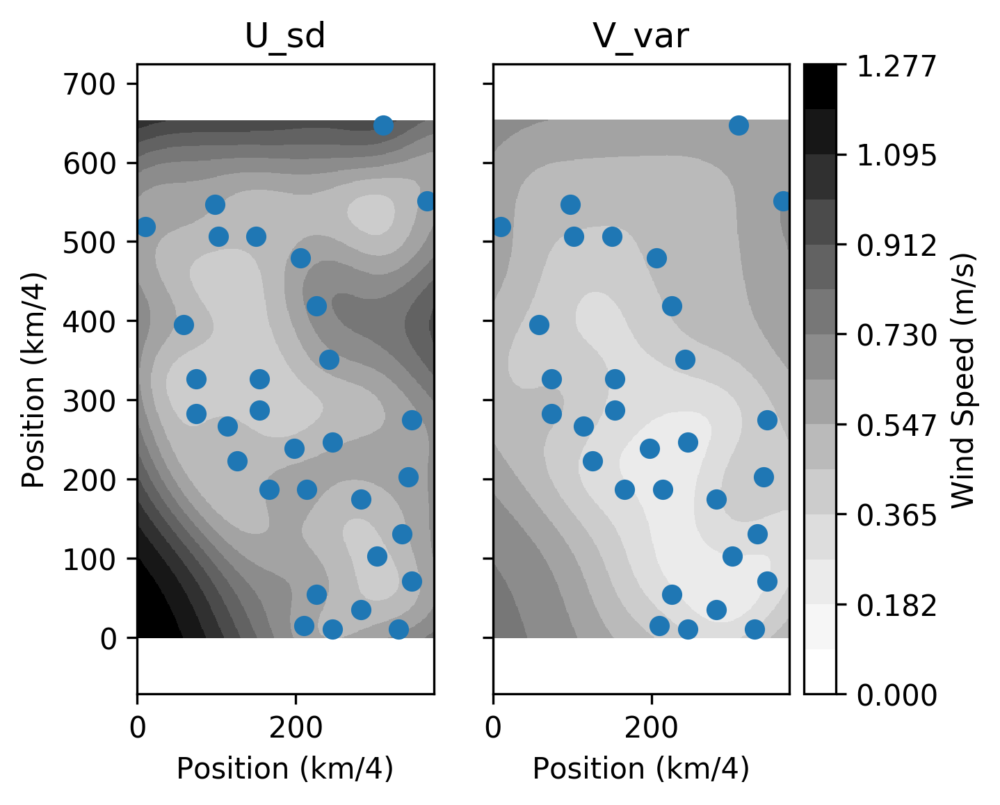

In [27]:
pos = np.array(np.unravel_index(u_flat_pos, sys_vars.U_crop_shape))
tp.wrf_opt_flow_plot(ensemble_no_opt_flow, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.wrf_opt_flow_plot(ensemble, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.opt_flow_sd_plot(ensemble_no_opt_flow, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.opt_flow_sd_plot(ensemble, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)

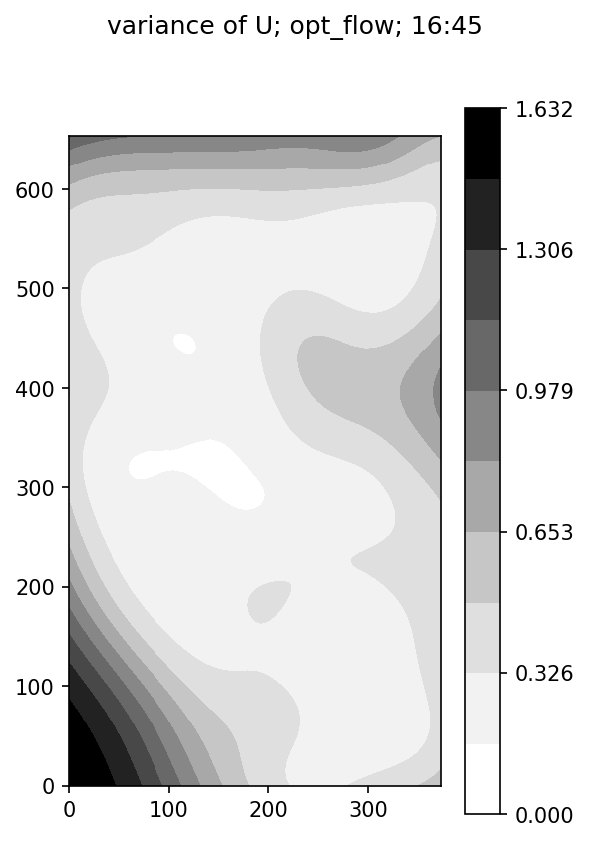

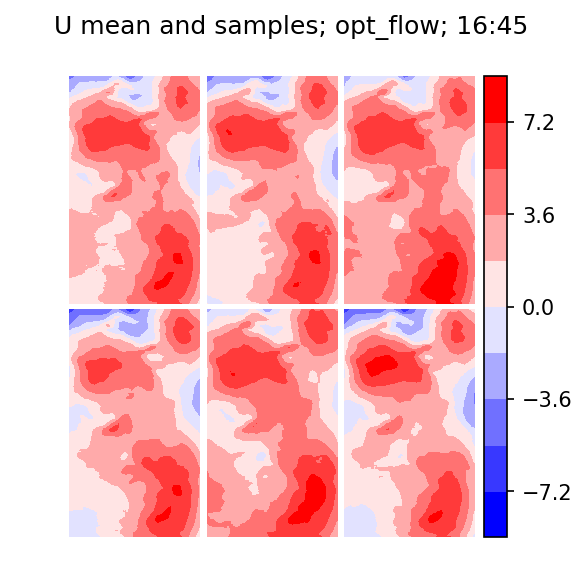

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


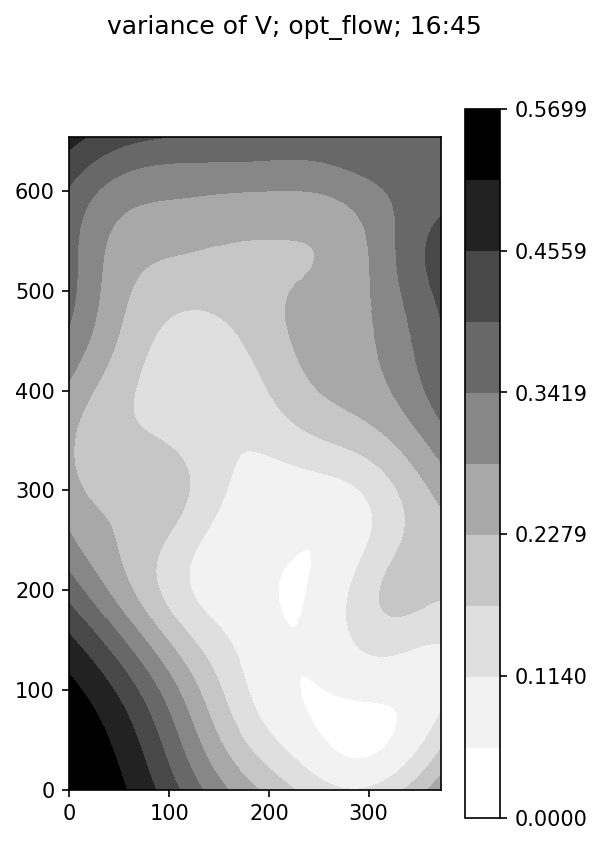

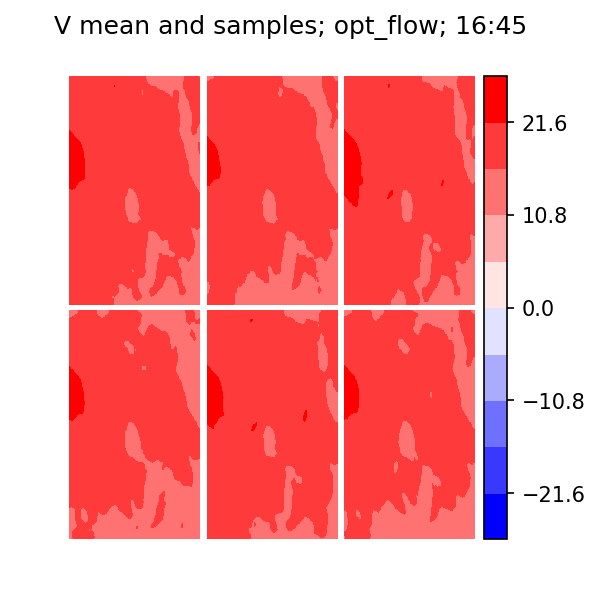

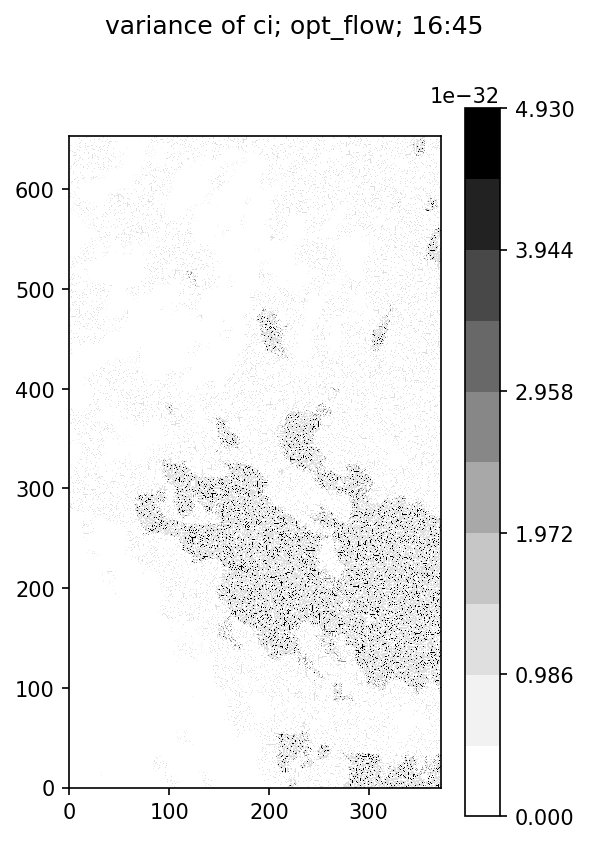

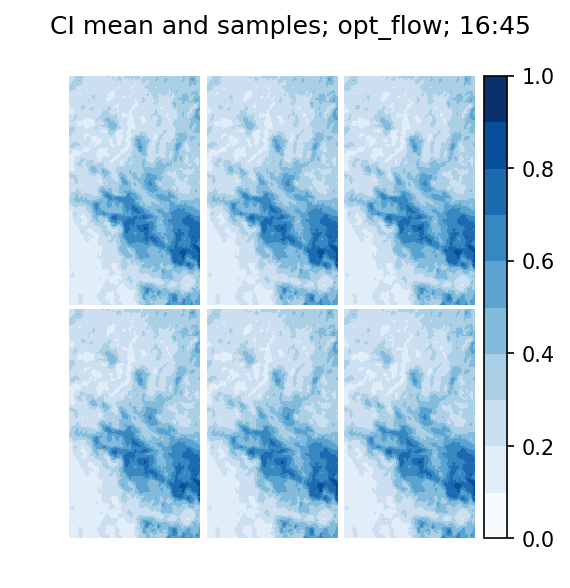

In [29]:
U_plots(ensemble, sat_time, 'opt_flow')
V_plots(ensemble, sat_time, 'opt_flow')
ci_plots(ensemble, sat_time, 'opt_flow')

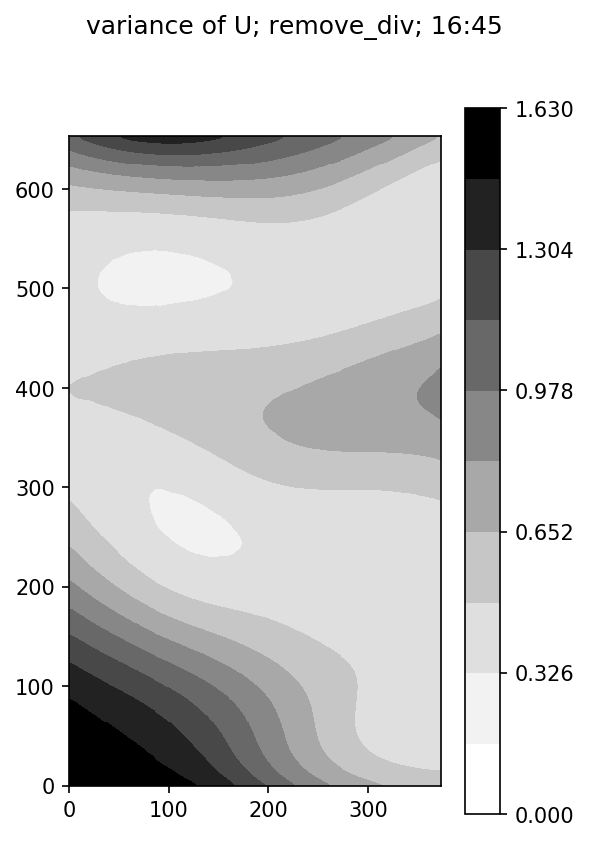

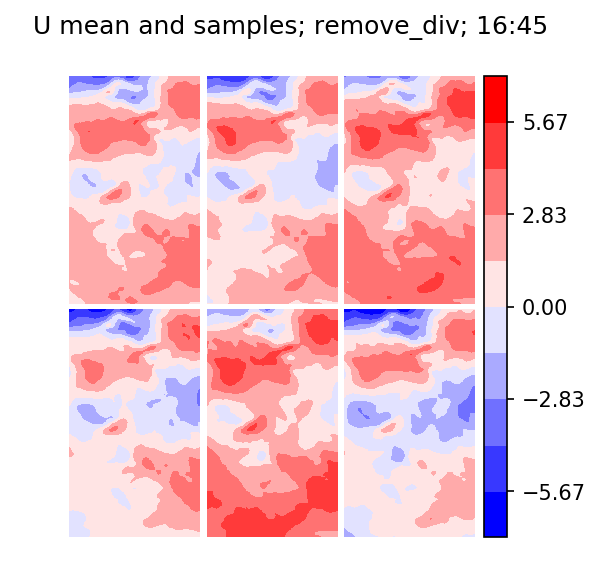

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


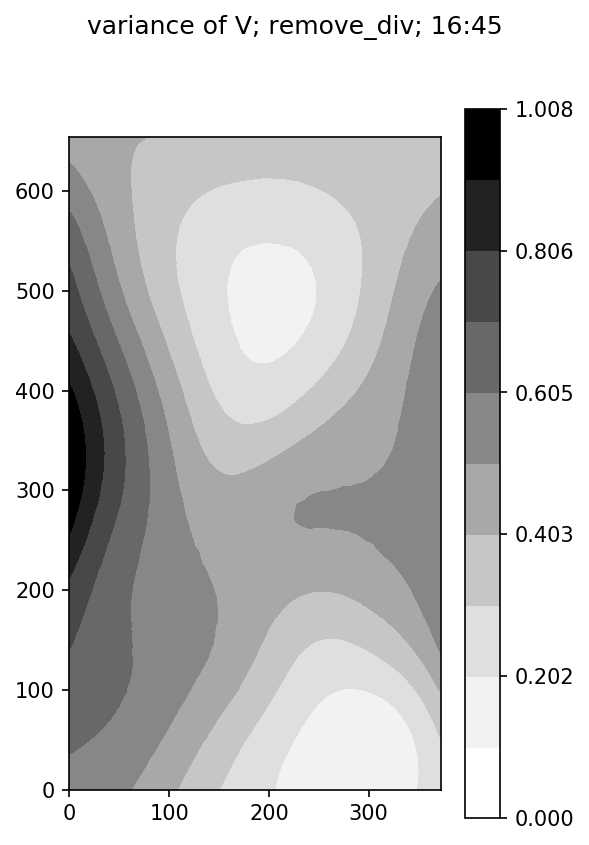

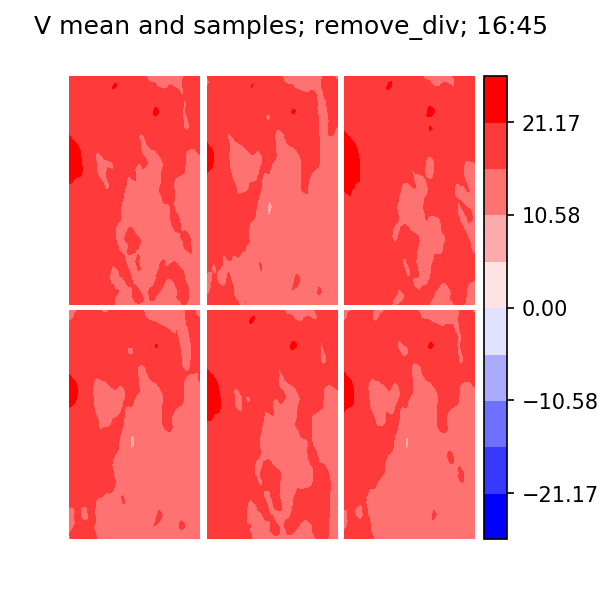

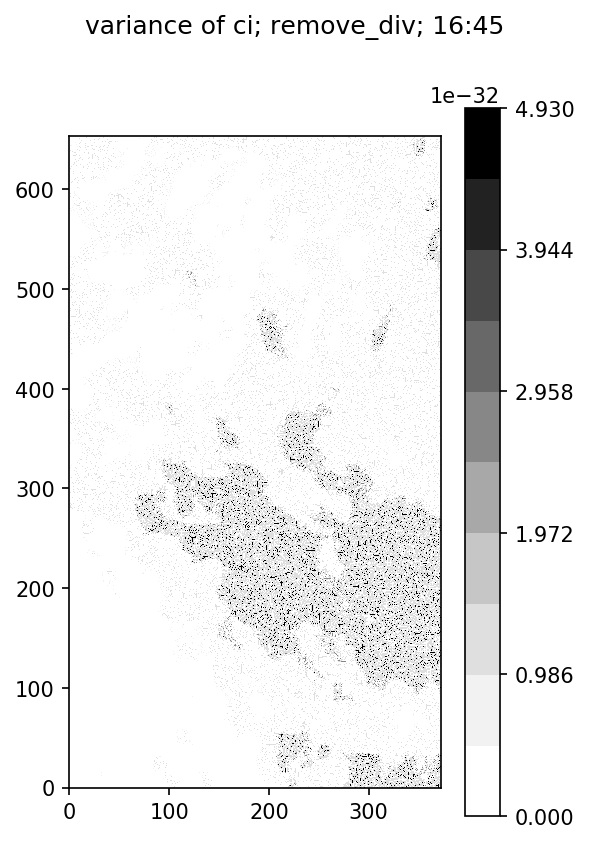

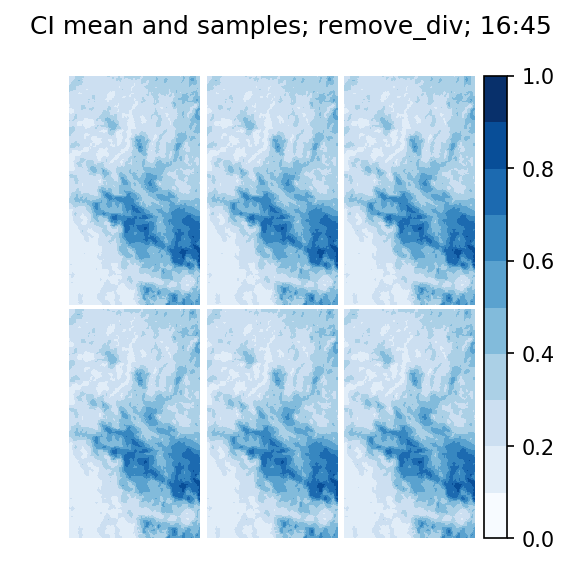

In [31]:
U_plots(ensemble, sat_time, 'remove_div')
V_plots(ensemble, sat_time, 'remove_div')
ci_plots(ensemble, sat_time, 'remove_div')

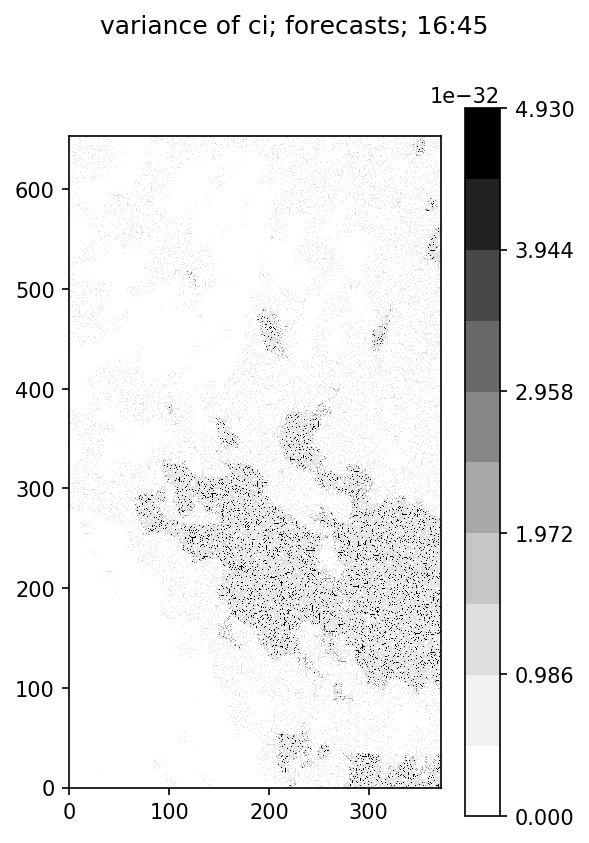

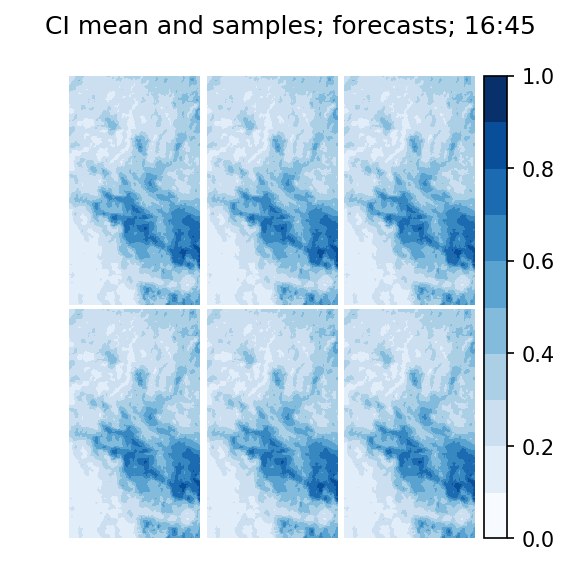

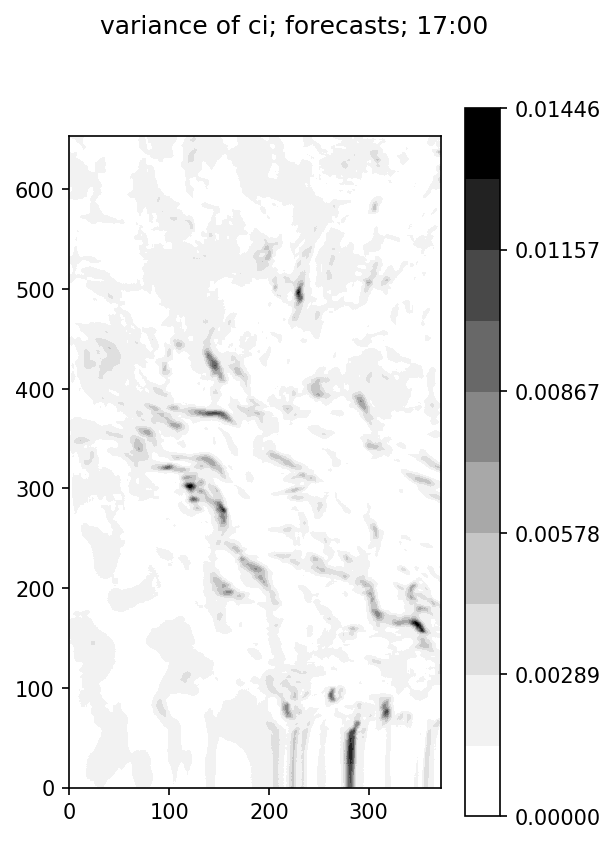

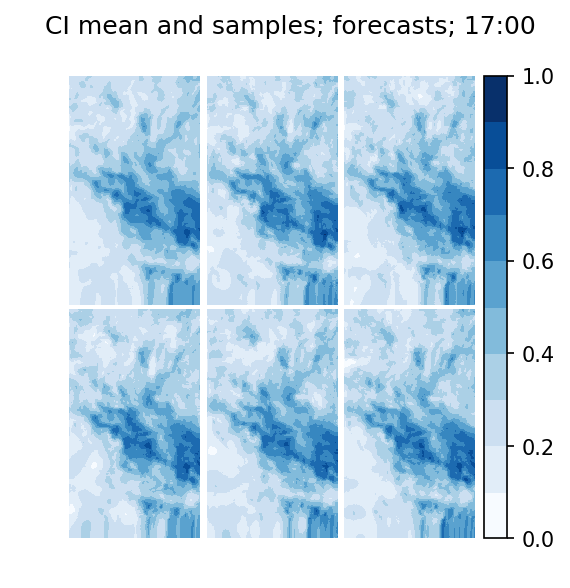

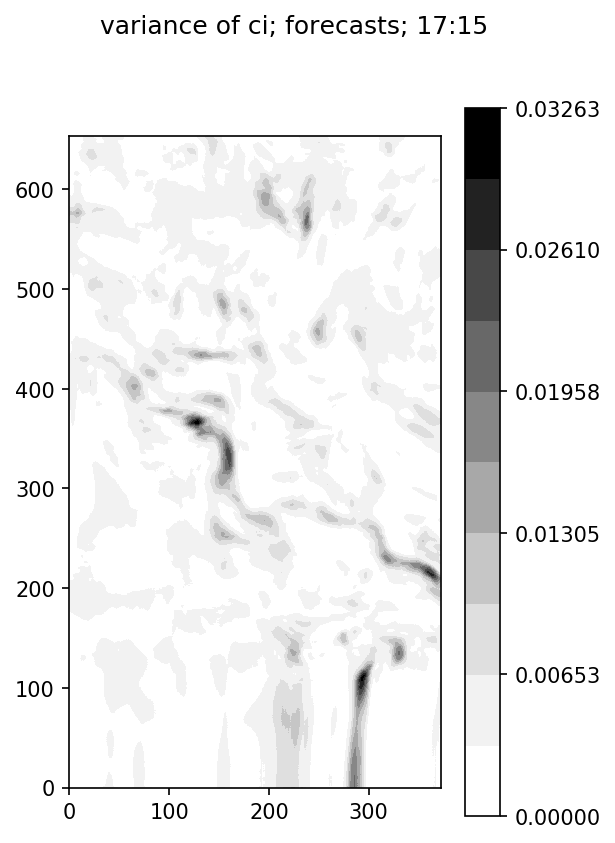

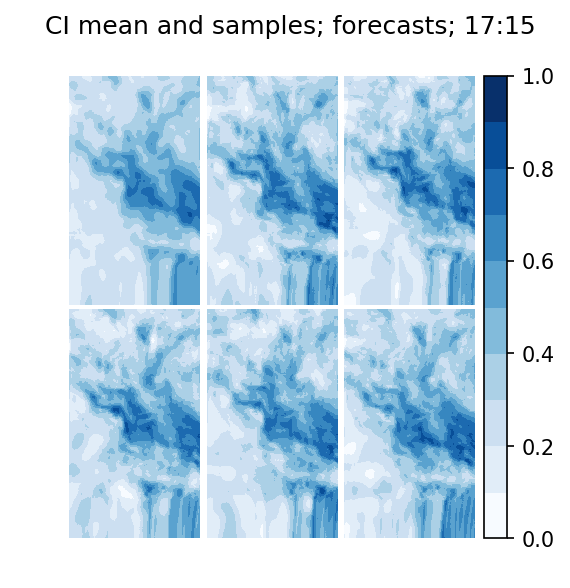

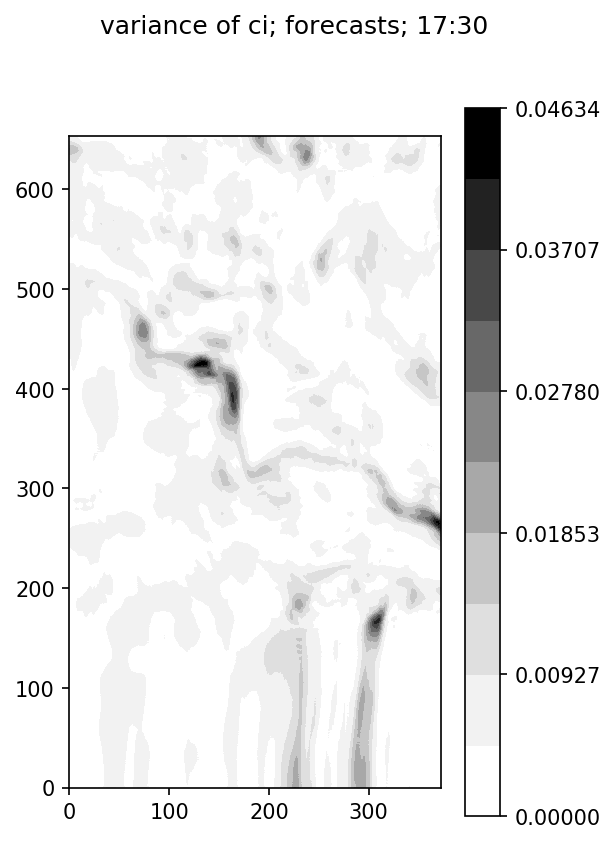

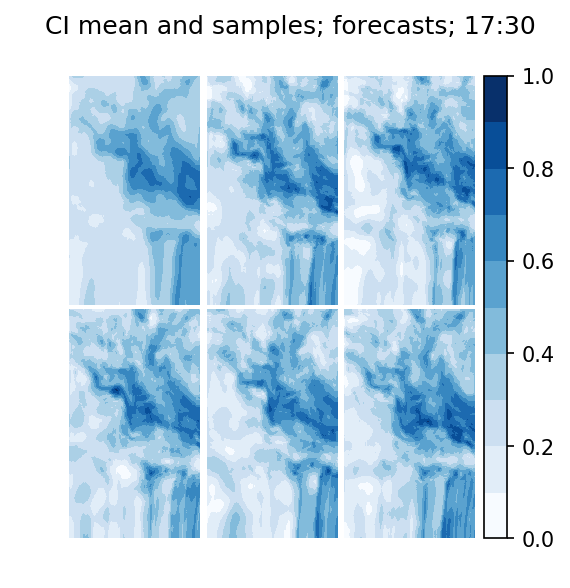

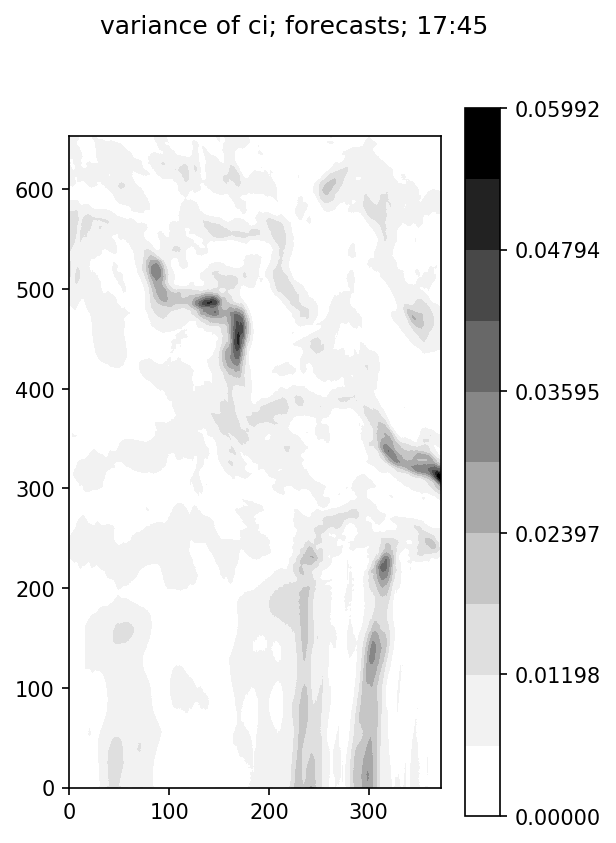

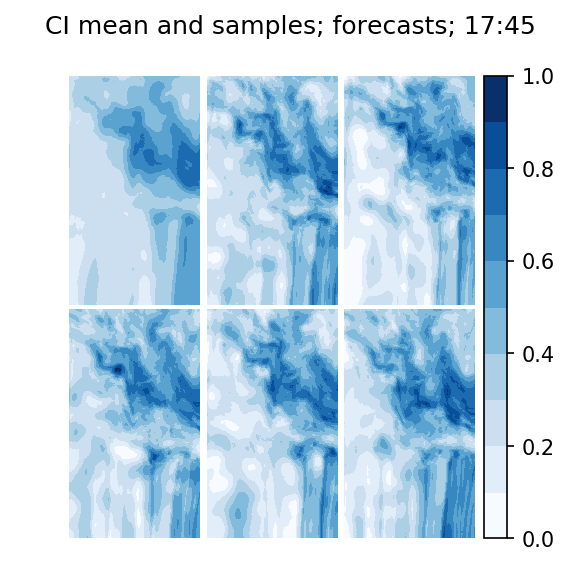

In [33]:
for ii in range(ensemble_array.shape[0]):
    ci_plots(ensemble_array[ii], save_times[ii], 'forecasts')

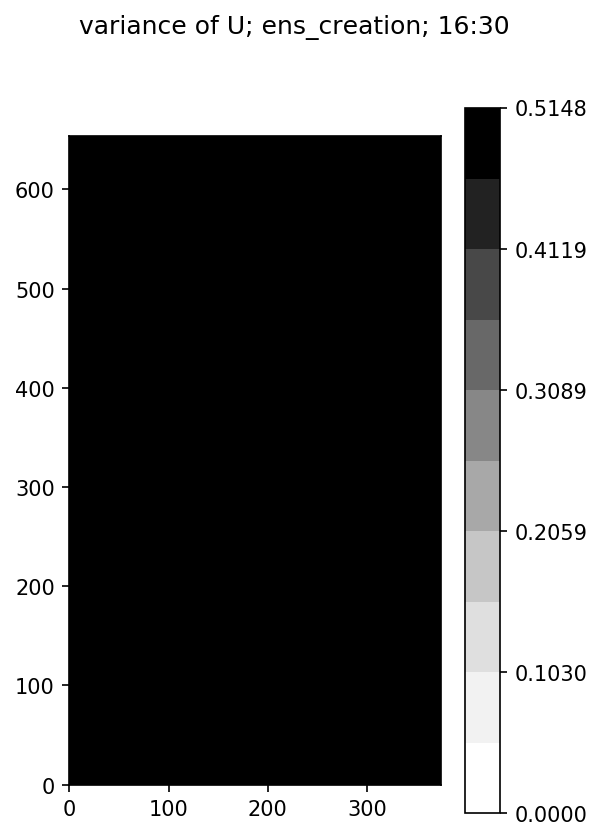

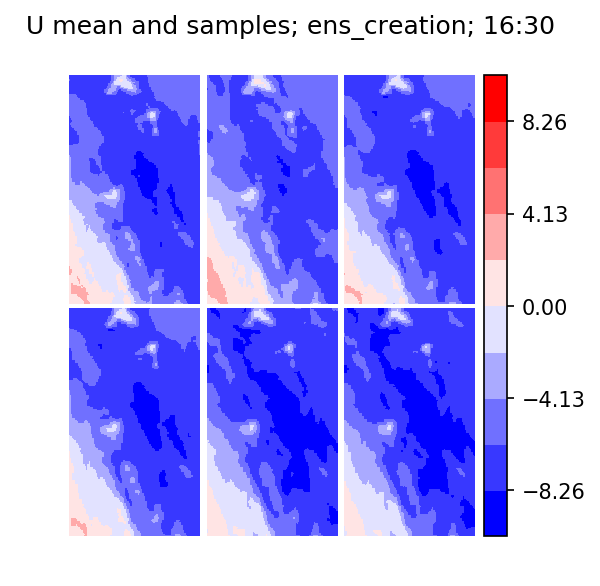

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


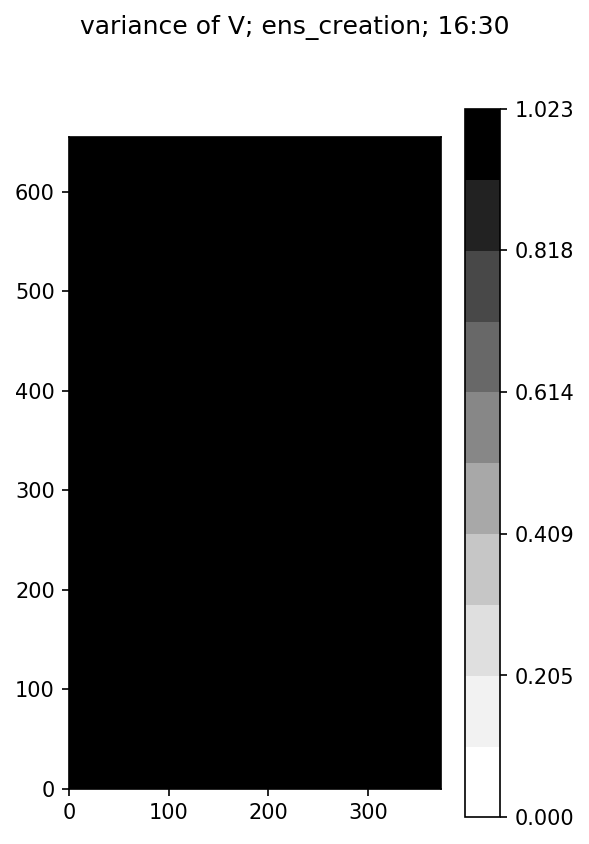

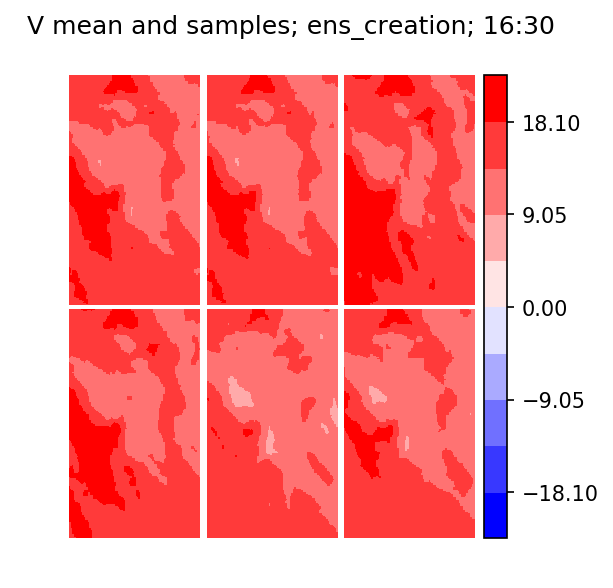

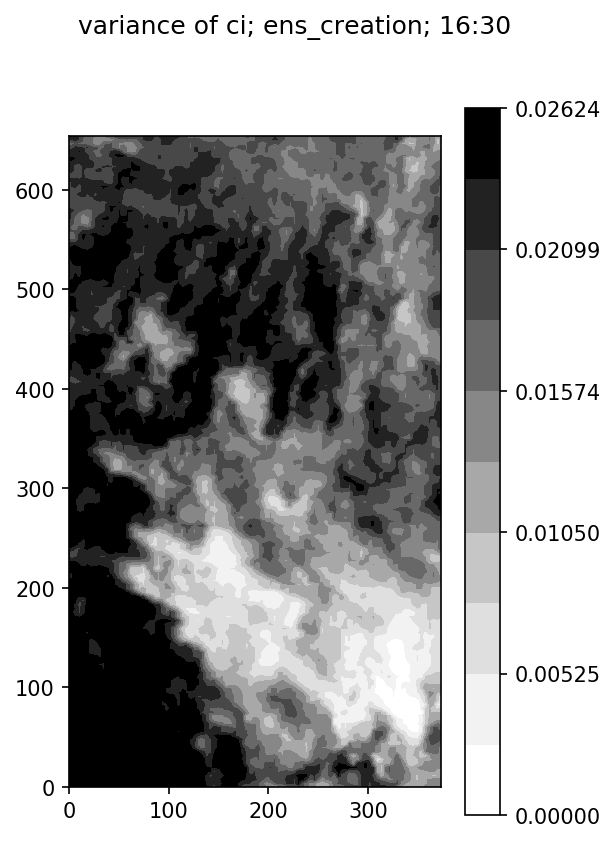

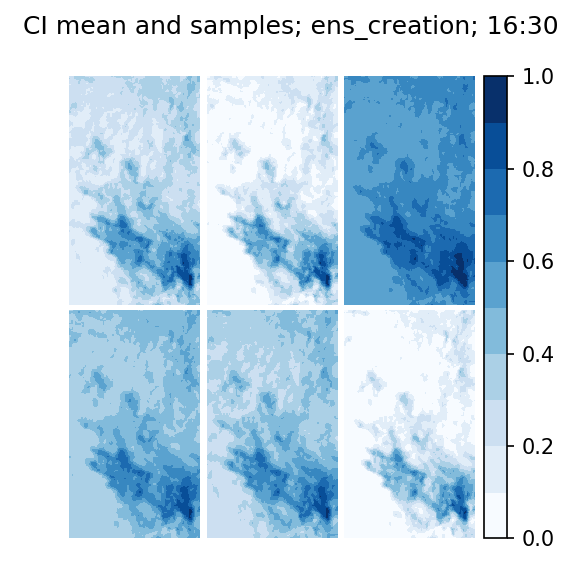

In [8]:
U_plots(ensemble, sat_times[0], 'ens_creation')
V_plots(ensemble, sat_times[0], 'ens_creation')
ci_plots(ensemble, sat_times[0], 'ens_creation')